In [1]:
import os, sys
import scanpy as sc
import pandas as pd
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import matplotlib.cm as cm
import anndata
import warnings
warnings.filterwarnings('ignore', category=anndata.ImplicitModificationWarning)
warnings.filterwarnings('ignore', category=FutureWarning)
# sys.path.insert(
#     0,
#     '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/script/spatial_pipeline/lib/utils'
# )
from STutils.pl import getDefaultColors
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.serif'] = ['Arial']
sc.settings.set_figure_params(dpi=100,dpi_save=300,frameon=False,facecolor='white',fontsize=12,vector_friendly=True,figsize=(5,5))
sc._settings.ScanpyConfig(figdir='./',n_jobs=30)

In [2]:
od = '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.21_scRNA_CAF_signature_socre'
os.system(f'mkdir -p {od}')
os.chdir(od)

In [3]:
adata = sc.read('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.7_CAF_scRNA_monocle2/CAF_recluster2.h5ad') 

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_tools/scatterplots.py:396: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


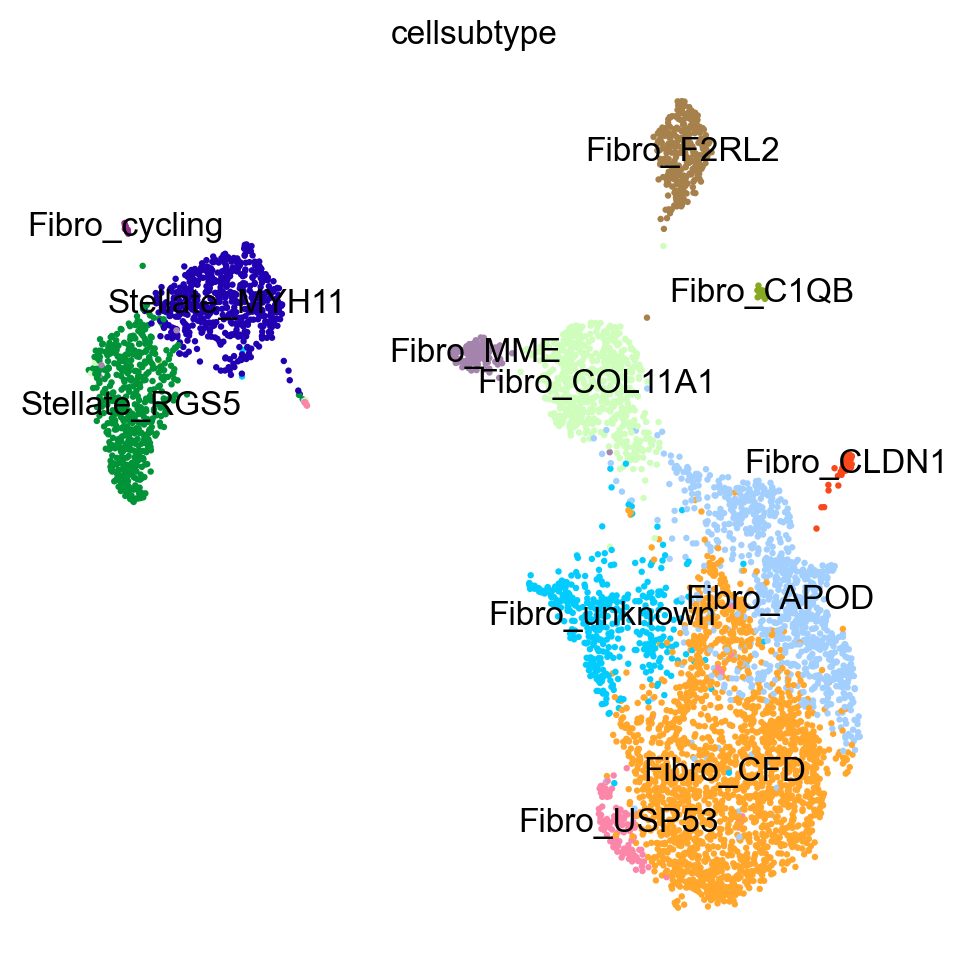

In [47]:
sc.settings.set_figure_params(
    dpi=100, dpi_save=300, frameon=False, facecolor="white", fontsize=12, vector_friendly=True, figsize=(5, 5)
)
colors = getDefaultColors(adata.obs["cellsubtype"].unique().shape[0], type=9)
sc.pl.umap(adata, color="cellsubtype", palette=colors, legend_loc="on data", save="CAF_cellsubtype.pdf")


In [10]:
sc.tl.rank_genes_groups(adata, groupby="cellsubtype", method="wilcoxon", use_raw=False)


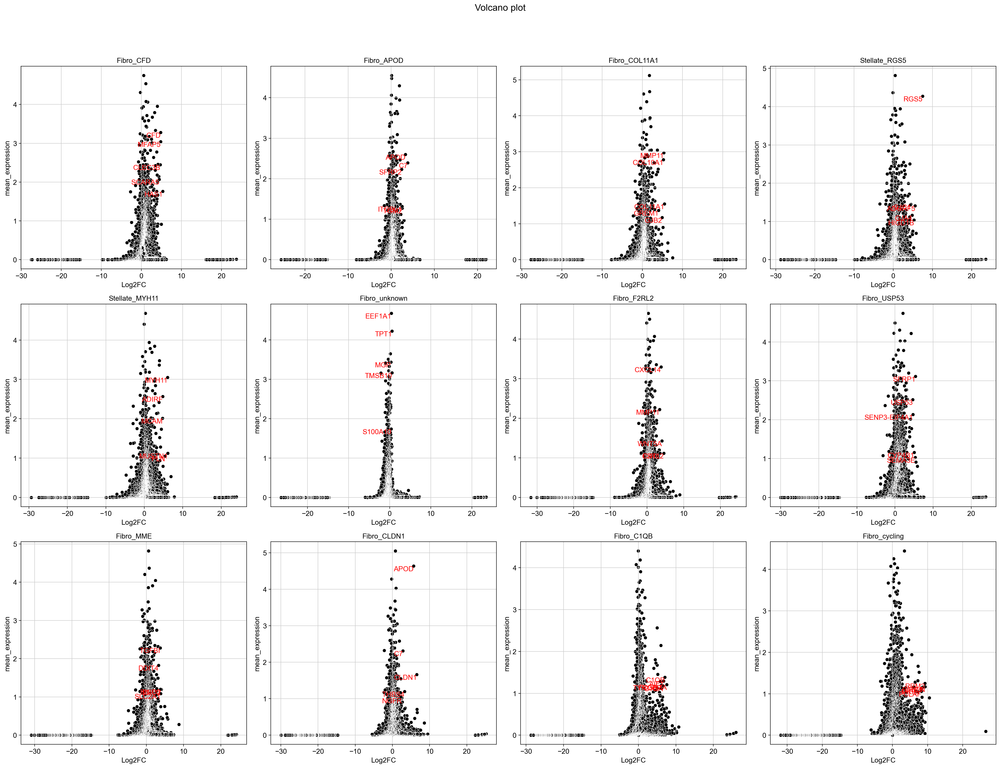

In [16]:
from STutils.tl import getDEG

DEG_dict = getDEG(
    adata,
    "cellsubtype",
    qval_cutoff=0.05,
    mean_expr_cutoff=1,
    #   layer='norm',
    top_genes=50,
    save=f"DEG_volcano.png",
)

In [17]:
degfl = open(f"DEG_CAF_subtype.xls", "w")
for key, value in DEG_dict.items():
    degfl.write(key + "\t" + "\t".join(value) + "\n")
degfl.close()
result = adata.uns["rank_genes_groups"]
groups = result["names"].dtype.names
df = pd.DataFrame(
    {
        group + "_" + key: result[key][group]
        for group in groups
        for key in ["names", "logfoldchanges", "pvals", "pvals_adj"]
    }
)
df.to_csv(f"DEG_wilcoxon_subtype_CAF.csv")

In [60]:
from collections import OrderedDict

DEG_dict = OrderedDict(
    [
        ("Fibro_APOD", ["C7", "APOD", "TGM2"]),
        ("Fibro_CFD", ["HAS1", "PLA2G2A", "CFD"]),
        ("Fibro_COL11A1", ["COL11A1", "MMP11", "COL10A1"]),
        ("Fibro_F2RL2", ["F2RL2", "WNT5A", "CXCL14"]),
        ("Fibro_USP53", ["USP53", "SFRP1", "SEMA3E"]),
        ("Fibro_MME", ["MME", "ENO2", "TGFBI"]),
        ("Fibro_CLDN1", ["CLDN1", "THBS4", "NGFR"]),
        ("Fibro_C1QB", ["C1QB", "C1QA", "TYROBP"]),
        ("Fibro_cycling", ["MKI67", "TOP2A", "ANLN"]),
        ("Fibro_unknown", ["TPT1", "TMSB10", "EEF1A1"]),
        ("Stellate_RGS5", ["RGS5", "ADGRF5", "GJC1"]),
        ("Stellate_MYH11", ["MYH11", "MUSTN1", "PLN"]),
    ]
)
sorted_DEG_dict = OrderedDict(sorted(DEG_dict.items(), key=lambda x: x[0]))
sorted_DEG_dict
DEG_list = [item for sublist in sorted_DEG_dict.values() for item in sublist]

In [59]:
DEG_list

OrderedDict([('Fibro_APOD', ['C7', 'APOD', 'TGM2']),
             ('Fibro_C1QB', ['C1QB', 'C1QA', 'TYROBP']),
             ('Fibro_CFD', ['HAS1', 'PLA2G2A', 'CFD']),
             ('Fibro_CLDN1', ['CLDN1', 'THBS4', 'NGFR']),
             ('Fibro_COL11A1', ['COL11A1', 'MMP11', 'COL10A1']),
             ('Fibro_F2RL2', ['F2RL2', 'WNT5A', 'CXCL14']),
             ('Fibro_MME', ['MME', 'ENO2', 'TGFBI']),
             ('Fibro_USP53', ['USP53', 'SFRP1', 'SEMA3E']),
             ('Fibro_cycling', ['MKI67', 'TOP2A', 'ANLN']),
             ('Fibro_unknown', ['TPT1', 'TMSB10', 'EEF1A1']),
             ('Stellate_MYH11', ['MYH11', 'MUSTN1', 'PLN']),
             ('Stellate_RGS5', ['RGS5', 'ADGRF5', 'GJC1'])])

In [54]:
colors
# rep colors 3 times for each color
colors2 = [item for sublist in [[i] * 3 for i in colors] for item in sublist]
colors2

['#a2cffe',
 '#a2cffe',
 '#a2cffe',
 '#87a922',
 '#87a922',
 '#87a922',
 '#ffa62b',
 '#ffa62b',
 '#ffa62b',
 '#f8481c',
 '#f8481c',
 '#f8481c',
 '#cffdbc',
 '#cffdbc',
 '#cffdbc',
 '#a6814c',
 '#a6814c',
 '#a6814c',
 '#a484ac',
 '#a484ac',
 '#a484ac',
 '#fc86aa',
 '#fc86aa',
 '#fc86aa',
 '#952e8f',
 '#952e8f',
 '#952e8f',
 '#02ccfe',
 '#02ccfe',
 '#02ccfe',
 '#2000b1',
 '#2000b1',
 '#2000b1',
 '#009337',
 '#009337',
 '#009337']

In [9]:
adata.obs["cellsubtype"] = adata.obs["cellsubtype"].cat.set_categories(
    adata.obs["cellsubtype"].cat.categories.sort_values()
)
adata.obs["cellsubtype"]

R492_CELL1093_N1        Fibro_F2RL2
R492_CELL81_N4        Fibro_COL11A1
R492_CELL11_N2       Stellate_MYH11
R492_CELL1188_N1          Fibro_MME
R492_CELL1402_N1          Fibro_MME
                          ...      
R1326_CELL4845_N1         Fibro_CFD
R1326_CELL4346_N1    Stellate_MYH11
R1326_CELL4621_N1    Stellate_MYH11
R1326_CELL5177_N1        Fibro_APOD
R1326_CELL4974_N1     Fibro_unknown
Name: cellsubtype, Length: 5594, dtype: category
Categories (12, object): ['Fibro_APOD', 'Fibro_C1QB', 'Fibro_CFD', 'Fibro_CLDN1', ..., 'Fibro_cycling', 'Fibro_unknown', 'Stellate_MYH11', 'Stellate_RGS5']

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


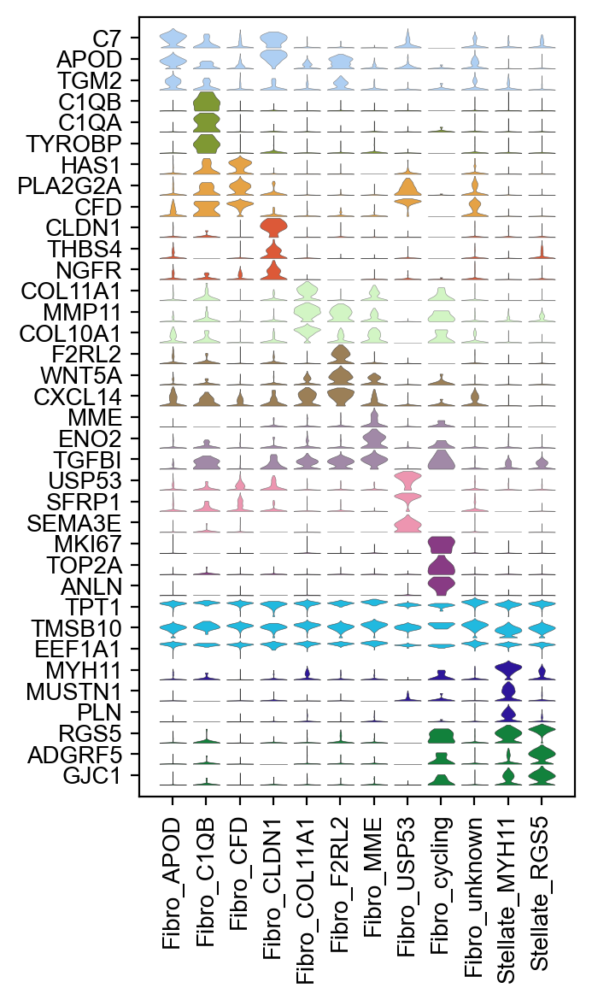

In [68]:
colors = getDefaultColors(adata.obs["cellsubtype"].unique().shape[0], type=9)

sc.pl.stacked_violin(
    adata,
    DEG_list,
    groupby="cellsubtype",
    save="stacked_violin_CAF_subtype_DEG_2.pdf",
    show=True,
    row_palette=colors2,
    stripplot=False,
    swap_axes=True,
    var_group_labels=None,
    figsize=(5, 6))


In [62]:
ax

<Axes: >

In [3]:
from ctxcore.genesig import *
import ctxcore


class GeneSignature2(ctxcore.genesig.GeneSignature):
  @classmethod
  def from_gmt(cls,
                fname: str,
                field_separator: str = "\t",
                gene_separator: str = "\t") -> List["GeneSignature"]:
      """
      Load gene signatures from a GMT file.

      :param fname: The filename.
      :param field_separator: The separator that separates fields in a line.
      :param gene_separator: The separator that separates the genes.
      :return: A list of signatures.
      """
      # https://software.broadinstitute.org/cancer/software/gsea/wiki/index.php/Data_formats
      assert os.path.exists(fname), f'"{fname}" does not exist.'

      def signatures():
          with openfile(fname, "r") as file:
              for line in file:
                  if isinstance(line, (bytes, bytearray)):
                      line = line.decode()
                  if line.startswith("#") or not line.strip():
                      continue
                  name, genes_str = re.split(field_separator,
                                              line.rstrip(),
                                              maxsplit=2)
                  genes = genes_str.split(gene_separator)[:30]
                  yield GeneSignature(name=name, gene2weight=genes)

      return list(signatures())

In [5]:
sig_CAF = GeneSignature.from_gmt(
    '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/database/signature/signature.gmt',
    field_separator='\t',
    gene_separator='\t')
CAF_list = [
    'Puram_CAF1', 'Puram_CAF2', 'Puram_Myofibroblast', 'Tuveson_iCAF',
    'Tuveson_myCAF', 'Tuveson_panCAF', 'Tuveson_apCAF', 'Chen_csCAF',
    'Chen_cCAF', 'Wang_meCAF', 'Wang_myCAF', 'Wang_apCAF', 'Wang_iCAF',
    'Wang_StellateCAF1', 'Wang_StellateCAF2', 'Cords_mCAF', 'Cords_iCAF',
    'Cords_vCAF', 'Cords_Pericyte', 'Cords_tCAF', 'Cords_hsp_tCAF',
    'Cords_ifnCAF', 'Cords_apCAF', 'Cords_rCAF', 'Cords_dCAF'
]

sig_CAF_selected = [i for i in sig_CAF if i.name in CAF_list]
from pyscenic.aucell import aucell

exp_mtx = pd.DataFrame(adata.X.toarray(),
                       index=adata.obs_names,
                       columns=adata.var_names)
auc_mtx = aucell(exp_mtx, sig_CAF_selected, noweights=True, num_workers=20)


Less than 80% of the genes in Cords_tCAF are present in the expression matrix.
Less than 80% of the genes in Wang_apCAF are present in the expression matrix.


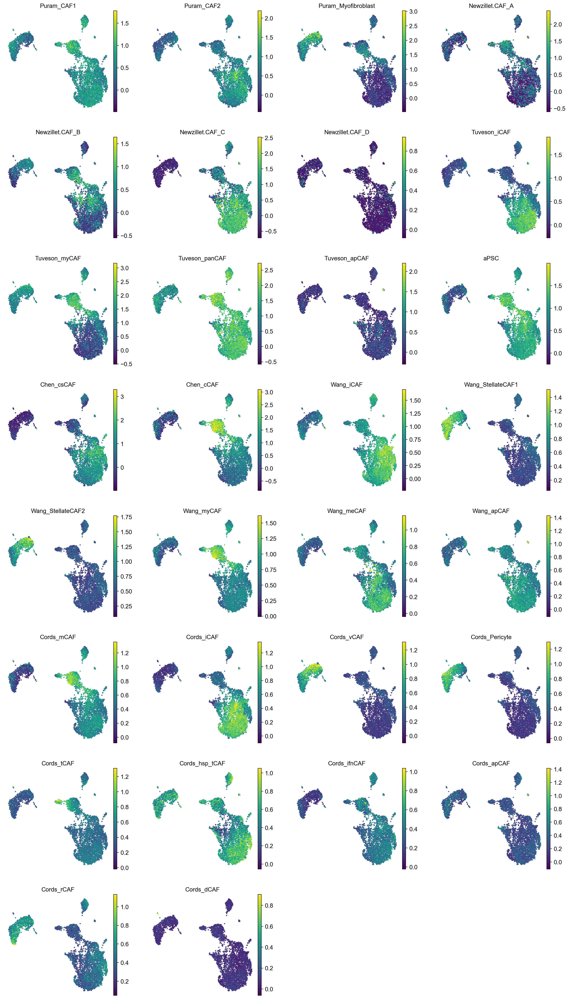

In [24]:
# adata.obs[auc_mtx.columns] = auc_mtx.fillna(0)
import matplotlib.colors as mcolors
cmap = mcolors.LinearSegmentedColormap.from_list("", ["lightgrey","green"])
sc.settings.set_figure_params(dpi=100,dpi_save=300,frameon=False,facecolor='white',fontsize=12,vector_friendly=True,figsize=(4,4))
sc.pl.umap(adata, color=auc_mtx.columns,palette=cmap,save='_CAF_subtype_public_reflect.pdf',ncols=4)

In [22]:
for key,value in sig_CAF_public_dict.items():
    sc.tl.score_genes(adata, gene_list = value,score_name=key)

In [14]:
for key,value in sig_CAF_local_dict.items():
    sc.tl.score_genes(adata, gene_list = value,score_name=key)

In [68]:
sig_CAF = GeneSignature2.from_gmt(
    '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.7_CAF_scRNA_monocle2/DEGs.txt',
    field_separator='\t',
    gene_separator=',')
CAF_list = ['Fibro_F2RL2','Fibro_USP53','Fibro_MME','Fibro_COL11A1','Fibro_CFD']
sig_CAF_selected = [i for i in sig_CAF if i.name in CAF_list]
from pyscenic.aucell import aucell
exp_mtx = pd.DataFrame(adata.X.toarray(),index=adata.obs_names,columns=adata.var_names)
auc_mtx = aucell(exp_mtx, sig_CAF, noweights=True, num_workers=20)


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


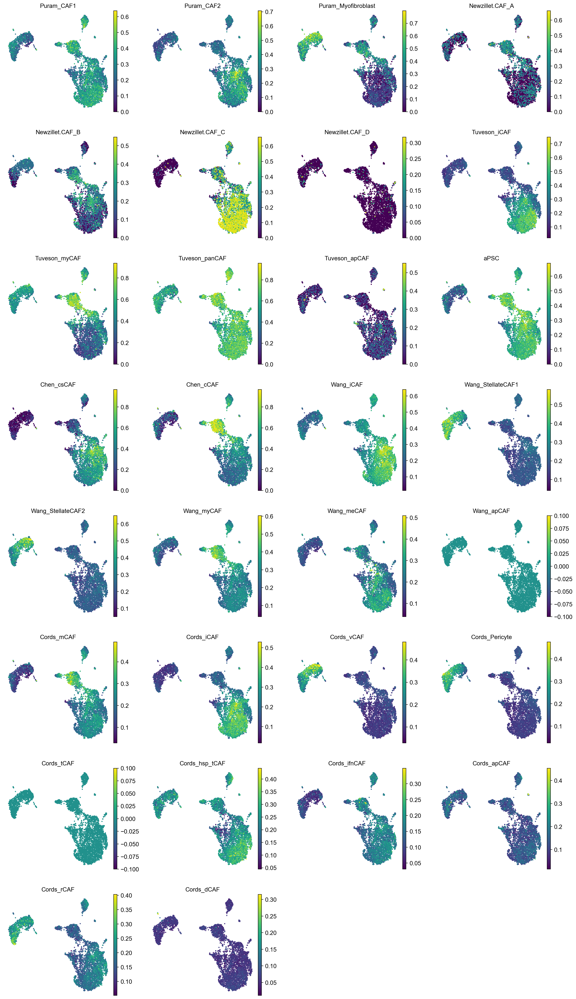

In [21]:
# adata.obs[auc_mtx.columns] = auc_mtx.fillna(0)
sc.settings.set_figure_params(dpi=100,dpi_save=300,frameon=False,facecolor='white',fontsize=12,vector_friendly=True,figsize=(4,4))
sc.pl.umap(adata, color=auc_mtx.columns,palette='viridis_r',save='_CAF_subtype_public_reflect2.pdf',ncols=4)

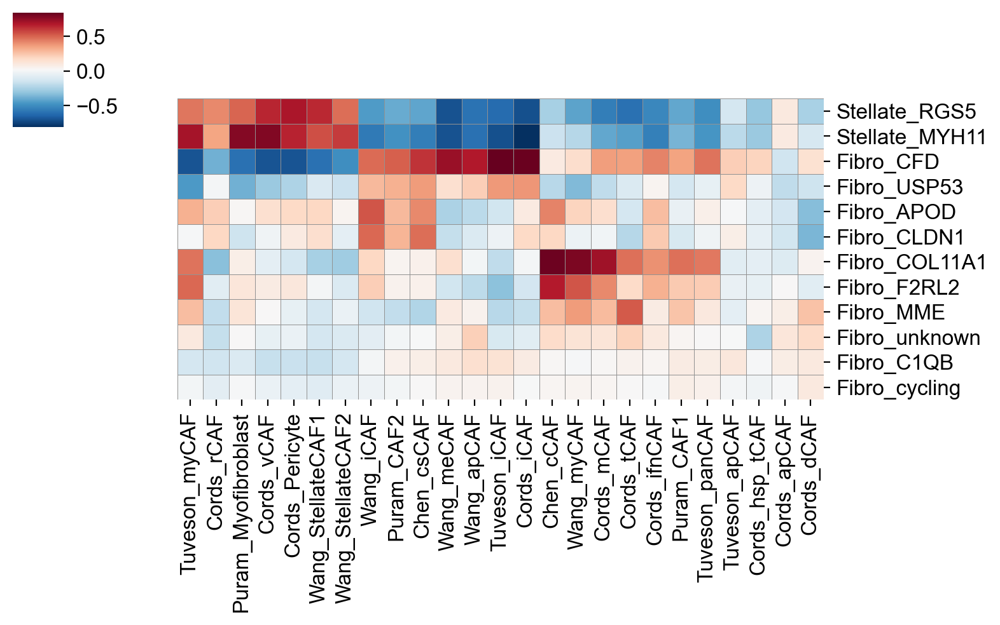

In [20]:
# score
CAF_list_public = [
    'Puram_CAF1', 'Puram_CAF2', 'Puram_Myofibroblast', 'Tuveson_iCAF',
    'Tuveson_myCAF', 'Tuveson_panCAF', 'Tuveson_apCAF', 'Chen_csCAF',
    'Chen_cCAF', 'Wang_meCAF', 'Wang_myCAF', 'Wang_apCAF', 'Wang_iCAF',
    'Wang_StellateCAF1', 'Wang_StellateCAF2', 'Cords_mCAF', 'Cords_iCAF',
    'Cords_vCAF', 'Cords_Pericyte', 'Cords_tCAF', 'Cords_hsp_tCAF',
    'Cords_ifnCAF', 'Cords_apCAF', 'Cords_rCAF', 'Cords_dCAF'
]
CAF_list_local = ['Fibro_CFD', 'Fibro_APOD', 'Fibro_COL11A1', 'Stellate_RGS5',
       'Stellate_MYH11', 'Fibro_unknown', 'Fibro_F2RL2', 'Fibro_USP53',
       'Fibro_MME', 'Fibro_CLDN1', 'Fibro_C1QB', 'Fibro_cycling']

score_mtx = adata.obs[CAF_list_public+CAF_list_local]
score_mtx = score_mtx.fillna(0)

# 计算相关性
correlation_matrix = score_mtx.corr(method='spearman')
correlation_matrix_subset = correlation_matrix.loc[CAF_list_local, CAF_list_public]
# 创建相关性热图
matplotlib.rcParams['axes.grid'] = False
cm = sns.clustermap(correlation_matrix_subset, col_cluster=True, row_cluster=True, cbar=True,cmap='RdBu_r',linewidth=.3,linecolor='#929292',figsize=(8,5))
cm.ax_row_dendrogram.set_visible(False)
cm.ax_col_dendrogram.set_visible(False)
plt.savefig('score_corr.pdf',bbox_inches='tight')

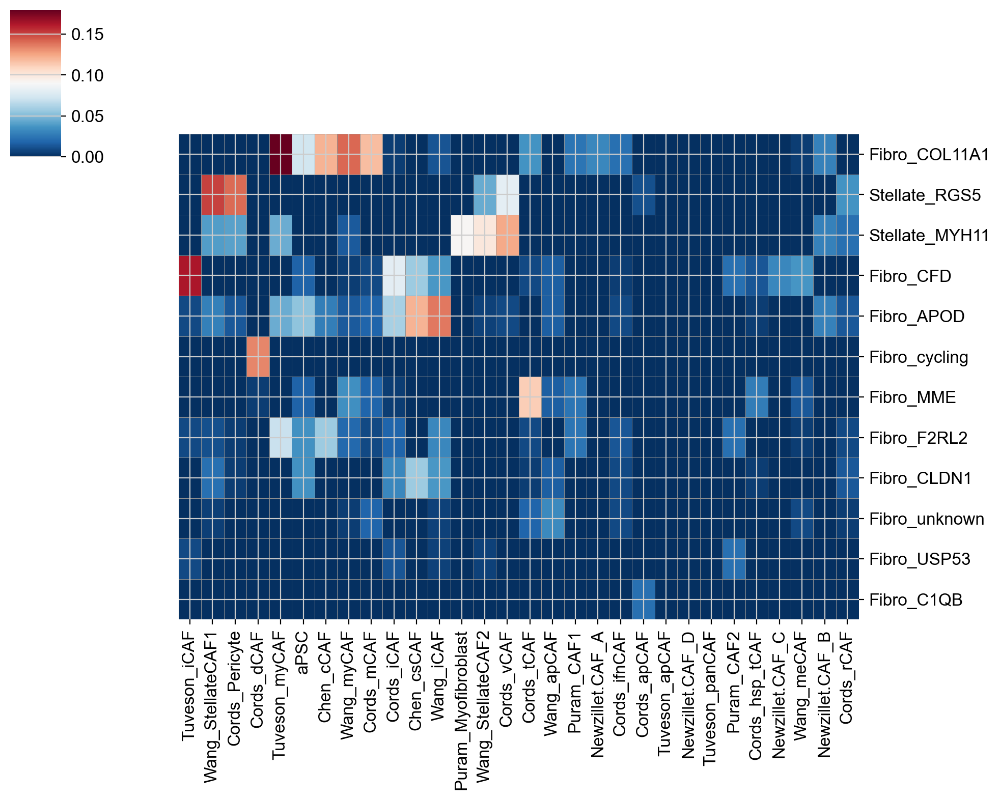

In [12]:
sig_CAF_public = GeneSignature.from_gmt(
    '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/database/signature/signature.gmt',
    field_separator='\t',
    gene_separator='\t')
CAF_list = [
    'Puram_CAF1', 'Puram_CAF2', 'Puram_Myofibroblast', 'Newzillet.CAF_A',
    'Newzillet.CAF_B', 'Newzillet.CAF_C', 'Newzillet.CAF_D', 'Tuveson_iCAF',
    'Tuveson_myCAF', 'Tuveson_panCAF', 'Tuveson_apCAF', 'aPSC', 'Chen_csCAF',
    'Chen_cCAF', 'Wang_meCAF', 'Wang_myCAF', 'Wang_apCAF', 'Wang_iCAF',
    'Wang_StellateCAF1', 'Wang_StellateCAF2', 'Cords_mCAF', 'Cords_iCAF',
    'Cords_vCAF', 'Cords_Pericyte', 'Cords_tCAF', 'Cords_hsp_tCAF',
    'Cords_ifnCAF', 'Cords_apCAF', 'Cords_rCAF', 'Cords_dCAF'
]
sig_CAF_public1 = [i for i in sig_CAF_public if i.name in CAF_list]
sig_CAF_local = GeneSignature2.from_gmt(
    '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.7_CAF_scRNA_monocle2/DEGs.txt',
    field_separator='\t',
    gene_separator=',')
CAF_list = [
    'Fibro_CFD', 'Fibro_APOD', 'Fibro_COL11A1', 'Stellate_RGS5',
    'Stellate_MYH11', 'Fibro_unknown', 'Fibro_F2RL2', 'Fibro_USP53',
    'Fibro_MME', 'Fibro_CLDN1', 'Fibro_C1QB', 'Fibro_cycling'
]
sig_CAF_local1 = [i for i in sig_CAF_local if i.name in CAF_list]
sig_CAF_public_dict = {}
for sig in sig_CAF_public1:
    sig_CAF_public_dict[sig.name] = sig.gene2weight.keys()
sig_CAF_local_dict = {}
for sig in sig_CAF_local1:
    sig_CAF_local_dict[sig.name] = sig.gene2weight.keys()
# calculate jaccard similarity between sig_CAF_public_dict and sig_CAF_local_dict
# Convert gene sets to sets of genes
public_genes_sets = {k: set(v) for k, v in sig_CAF_public_dict.items()}
local_genes_sets = {k: set(v) for k, v in sig_CAF_local_dict.items()}

# Calculate Jaccard similarity
jaccard_similarity_scores = pd.DataFrame(index=public_genes_sets.keys(),
                                         columns=local_genes_sets.keys())
for public_sig, public_genes in public_genes_sets.items():
    for local_sig, local_genes in local_genes_sets.items():
        intersection = len(public_genes.intersection(local_genes))
        union = len(public_genes.union(local_genes))
        jaccard_similarity = intersection / union if union != 0 else 0
        jaccard_similarity_scores.loc[public_sig,
                                      local_sig] = jaccard_similarity
jaccard_similarity_scores = jaccard_similarity_scores.astype('float')
cm = sns.clustermap(jaccard_similarity_scores.T,
                    col_cluster=True,
                    row_cluster=True,
                    cbar=True,
                    cmap='RdBu_r',
                    linewidth=.3,
                    linecolor='#929292',
                    figsize=(10, 8))
cm.ax_row_dendrogram.set_visible(False)
cm.ax_col_dendrogram.set_visible(False)
plt.savefig('score_corr_jaccard.pdf', bbox_inches='tight')


In [142]:
jaccard_similarity_scores

,Fibro_CFD,Fibro_APOD,Fibro_COL11A1,Stellate_RGS5,Stellate_MYH11,Fibro_unknown,Fibro_F2RL2,Fibro_USP53,Fibro_MME,Fibro_CLDN1
Puram_CAF1,0.0,0.0,0.02439,0.0,0.0,0.0,0.02439,0.0,0.02439,0.0
Puram_CAF2,0.022222,0.0,0.0,0.0,0.0,0.0,0.022222,0.022222,0.0,0.0
Puram_Myofibroblast,0.0,0.0,0.0,0.0,0.090909,0.0,0.0,0.0,0.0,0.0
aPSC,0.017241,0.053571,0.072727,0.0,0.0,0.0,0.035088,0.0,0.017241,0.035088
Chen_csCAF,0.057143,0.121212,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.057143
Chen_cCAF,0.0,0.027778,0.121212,0.0,0.0,0.0,0.057143,0.0,0.0,0.0
Wang_iCAF,0.0375,0.136986,0.012195,0.0,0.0,0.006061,0.031056,0.006061,0.0,0.0375
Wang_StellateCAF1,0.0,0.02809,0.0,0.150943,0.039773,0.005495,0.01105,0.0,0.0,0.022346
Wang_StellateCAF2,0.0,0.006098,0.0,0.044304,0.1,0.0,0.0,0.006098,0.0,0.0
Wang_myCAF,0.004785,0.014493,0.141304,0.0,0.014493,0.004785,0.019417,0.0,0.034483,0.0


In [70]:
adata.write('CAF_recluster.h5ad')

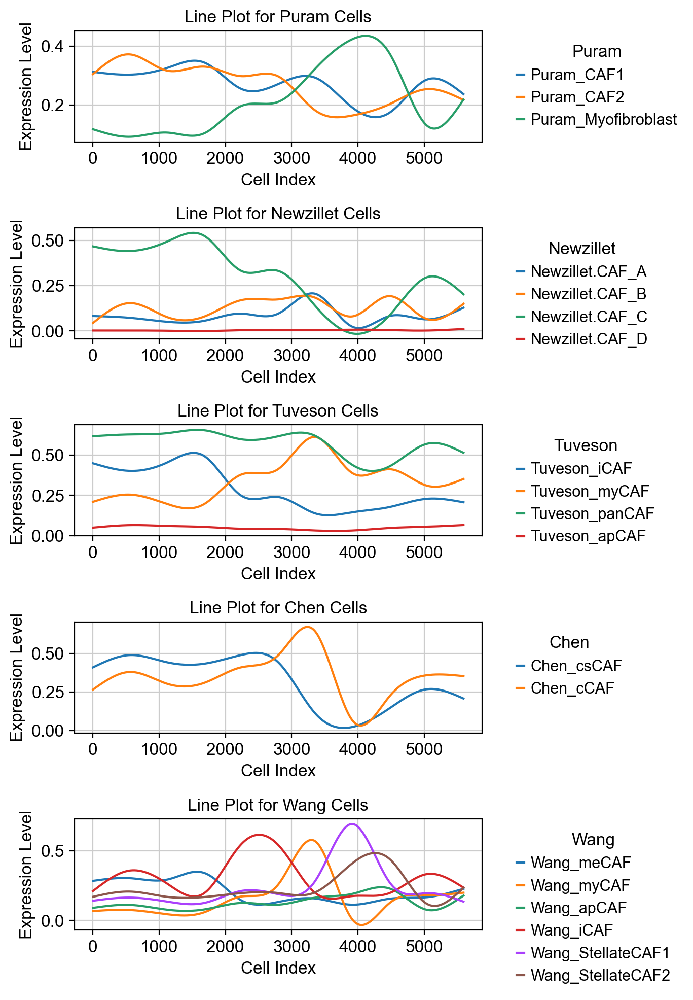

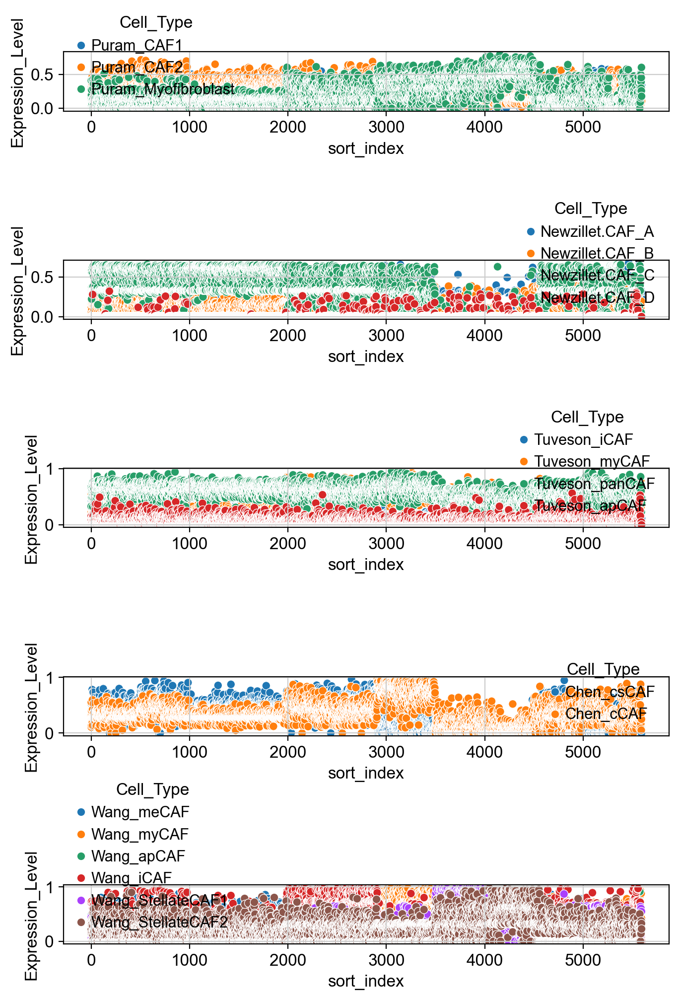

In [64]:
# adata = sc.read('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.7_CAF_scRNA_monocle2/CAF_recluster2.h5ad')
CAF_list = ['Puram_CAF1','Puram_CAF2','Puram_Myofibroblast','Newzillet.CAF_A','Newzillet.CAF_B','Newzillet.CAF_C','Newzillet.CAF_D','Tuveson_iCAF','Tuveson_myCAF','Tuveson_panCAF','Tuveson_apCAF','Chen_csCAF','Chen_cCAF','Wang_meCAF','Wang_myCAF','Wang_apCAF','Wang_iCAF','Wang_StellateCAF1','Wang_StellateCAF2']
# sort cells by adata.obs['pseudotime'] and draw line plot of CAF_list, different prefix plot in same plot, different prefix plot in different plot
# 按照 'pseudotime' 列对细胞进行排序
adata = adata[adata.obs['cellsubtype'].argsort()]
adata.obs['sort_index'] = range(adata.shape[0])
# 定义不同前缀的细胞列表
prefixes = ['Puram', 'Newzillet', 'Tuveson', 'Chen', 'Wang']
from sklearn.linear_model import LinearRegression
from patsy import cr

    
# 绘制不同前缀的细胞在不同图中
fig, axs = plt.subplots(5, 1, figsize=(7, 10))
for i, prefix in enumerate(prefixes):
    prefix_list = [cell for cell in CAF_list if cell.startswith(prefix)]
    data_tmp = adata.obs[['sort_index'] + prefix_list]
    data_tmp_melt = data_tmp.melt(id_vars='sort_index', var_name='Cell_Type', value_name='Expression_Level')
    # line plot of prefix_list
    for cell_type in data_tmp_melt['Cell_Type'].unique():
        ax = axs[i]
        x = data_tmp_melt[data_tmp_melt['Cell_Type'] == cell_type]['sort_index']
        y = data_tmp_melt[data_tmp_melt['Cell_Type'] == cell_type]['Expression_Level']
        # 使用插值平滑曲线
        x_basis = cr(x, df=10, constraints="center")
        model = LinearRegression().fit(x_basis, y)
        ynew = model.predict(x_basis)
        # xnew = range(data_tmp_melt['sort_index'].min(), data_tmp_melt['sort_index'].max())
        ax.plot(x, ynew, label=cell_type)
        # sns.lineplot(x='sort_index', y='Expression_Level', hue='Cell_Type', data=data_tmp_melt,ax=axs[i])
        ax.set_title(f'Line Plot for {prefix} Cells')
        ax.set_xlabel('Cell Index')
        ax.set_ylabel('Expression Level')
        ax.legend(title=prefix,
               bbox_to_anchor=(1.05, 1),
               loc='upper left')
fig.savefig('scRNA_CAF_signature_socre_lineplot.pdf', bbox_inches='tight')



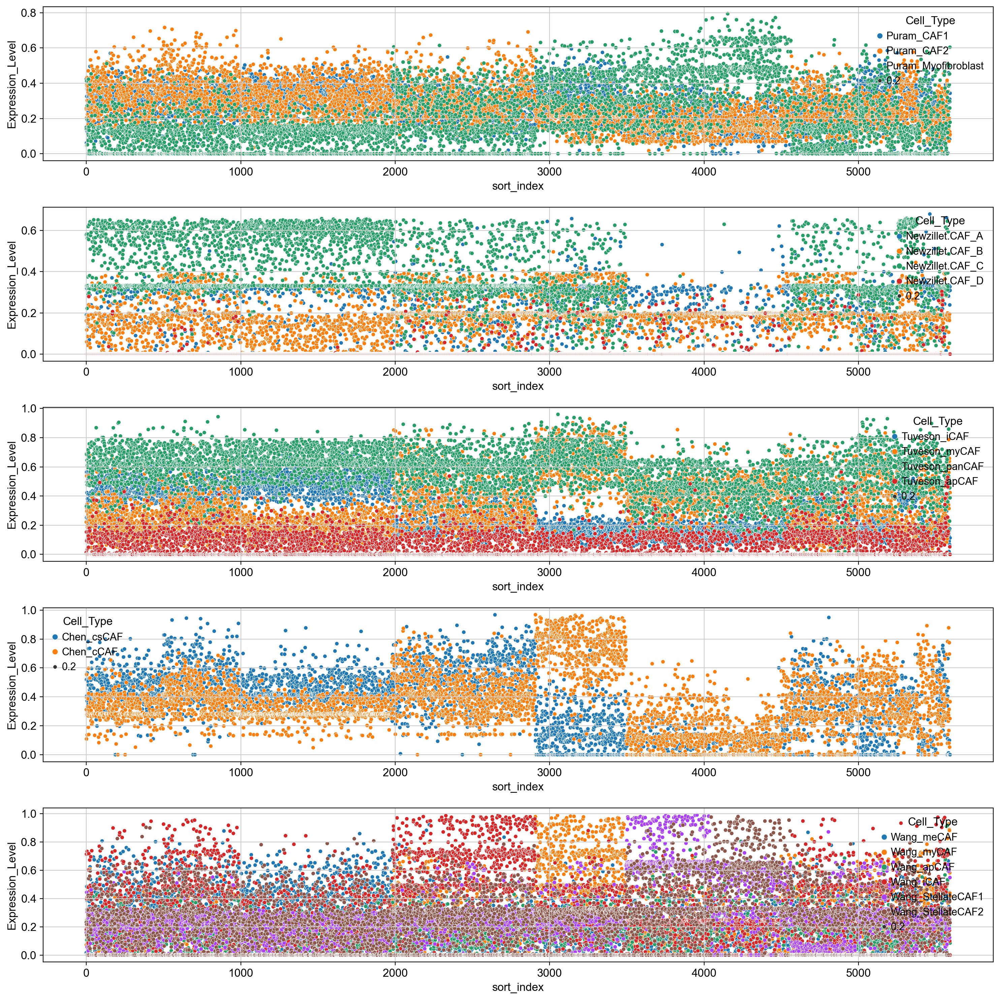

In [67]:
fig, axs = plt.subplots(5, 1, figsize=(15, 15))
for i, prefix in enumerate(prefixes):
    prefix_list = [cell for cell in CAF_list if cell.startswith(prefix)]
    data_tmp = adata.obs[['sort_index'] + prefix_list]
    data_tmp_melt = data_tmp.melt(id_vars='sort_index', var_name='Cell_Type', value_name='Expression_Level')
    # draw scatter plot of prefix_list
    sns.scatterplot(x='sort_index', y='Expression_Level', hue='Cell_Type', size=.2,data=data_tmp_melt,ax=axs[i])
    ax.set_title(f'Line Plot for {prefix} Cells')
    ax.set_xlabel('Cell Index')
    ax.set_ylabel('Expression Level')
    ax.legend(title=prefix,
            bbox_to_anchor=(1.05, 1),
            loc='upper left')
fig.savefig('scRNA_CAF_signature_socre_dotplot.pdf', bbox_inches='tight')

In [58]:
adata.obs['cellsubtype']

R1323_CELL487_N2         Fibro_CFD
R1326_CELL1304_N1        Fibro_CFD
R645_CELL9788_N1         Fibro_CFD
R1324_CELL505_N2         Fibro_CFD
R1326_CELL1203_N1        Fibro_CFD
                         ...      
R1328_CELL1362_N1    Fibro_cycling
R1097_CELL4696_N1    Fibro_cycling
R645_CELL4194_N1     Fibro_cycling
R493_CELL373_N2      Fibro_cycling
R990_CELL1808_N1     Fibro_cycling
Name: cellsubtype, Length: 5594, dtype: category
Categories (12, object): ['Fibro_CFD', 'Fibro_APOD', 'Fibro_COL11A1', 'Stellate_RGS5', ..., 'Fibro_MME', 'Fibro_CLDN1', 'Fibro_C1QB', 'Fibro_cycling']

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


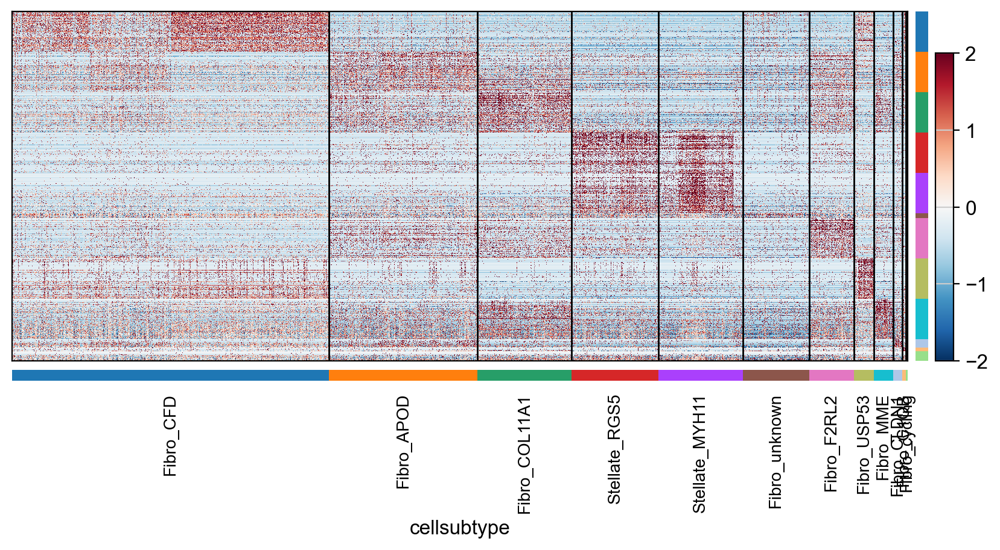

In [47]:
# adatascaled = sc.pp.scale(adata,layer=None,copy=True)
# adata.layers['norm_scaled'] = adatascaled.X
# sc.tl.rank_genes_groups(adata, groupby='cellsubtype', method='wilcoxon')
# DEG_dict = getDEG(adata, 'cellsubtype', qval_cutoff=0.05, mean_expr_cutoff=0.2,top_genes=200,save=f'DEG_volcano_celltype.png')
sc.pl.heatmap(adata, DEG_dict,groupby='cellsubtype',layer='norm_scaled',cmap='RdBu_r',vmin=-2,vmax=2, swap_axes=True,save='_CAF_subtype_public_reflect.pdf')

In [50]:
adata

AnnData object with n_obs × n_vars = 5594 × 25506
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'group', 'percent.mt', 'pANN_0.25_0.005_201', 'doublet_info', 'RNA_snn_res.0.4', 'seurat_clusters', 'RNA_snn_res.0.5', 'RNA_snn_res.0.8', 'RNA_snn_res.1.2', 'RNA_snn_res.1', 'celltype', 'pANN_0.25_0.18_1130', 'pANN_0.25_0.005_152', 'pANN_0.25_0.01_119', 'pANN_0.25_0.03_36', 'pANN_0.25_0.02_66', 'pANN_0.25_0.005_402', 'pANN_0.25_0.001_1065', 'pANN_0.25_0.005_193', 'pANN_0.25_0.001_1420', 'pANN_0.25_0.005_713', 'pANN_0.25_0.03_123', 'pANN_0.25_0.05_760', 'pANN_0.25_0.005_420', 'pANN_0.25_0.27_608', 'pANN_0.25_0.04_76', 'pANN_0.25_0.001_977', 'pANN_0.25_0.005_285', 'pANN_0.25_0.01_124', 'pANN_0.25_0.01_135', 'pANN_0.25_0.02_41', 'pANN_0.25_0.005_255', 'pANN_0.25_0.05_548', 'pANN_0.25_0.005_534', 'pANN_0.25_0.005_513', 'Patients', 'cellTypes', 'sample', 'tissue', 'cellTypes_new', 'cellTypes_filt', 'sampleType', 'RNA_snn_res.0.6', 'RNA_snn_res.0.7', 'RNA_snn_res.0.9', 'RNA_snn_res.1.1', 'R

In [55]:
var_names, var_group_labels, var_group_positions = sc.pl._anndata._check_var_names_type(
    var_names=DEG_dict, var_group_labels=None, var_group_positions=None
)
categories, obs_tidy = sc.pl._anndata._prepare_dataframe(
    adata,
    var_names=var_names,
    groupby='cellsubtype',
    use_raw=False,
    log=False,
    num_categories=7,
    gene_symbols=None,
    layer='norm_scaled',
)
obs_tidy = obs_tidy.sort_index()

In [56]:
obs_tidy

,HAS1,ADAMTS16,MFAP5,CFD,CLEC3B,SCARA5,MEDAG,PENK,EXOSC7,PI16,...,HNRNPA3,GAPDH,CALM1,SET,TPM4,NUCKS1,CALU,ACTB,VIM,PPIA
cellsubtype,,,,,,,,,,,,,,,,,,,,,
Fibro_CFD,2.362011,0.936274,1.584508,1.250973,2.029067,1.274877,1.337858,1.458004,2.003953,1.231626,...,-0.532423,-0.162467,-0.515657,0.837832,-0.020250,-0.080793,0.458168,-0.352281,0.124401,0.110460
Fibro_CFD,-0.122994,0.292265,1.336255,1.322452,1.364597,1.389066,1.247240,-0.271342,1.271223,0.917400,...,-0.062845,-0.282274,-0.122362,-0.846855,0.740046,-0.070285,0.180173,-0.007212,-0.377410,0.301533
Fibro_CFD,-0.590708,-0.514252,-0.858326,-0.870234,-0.731965,-0.743330,-0.790461,-0.271342,-0.824052,-0.619373,...,0.667988,0.192785,1.339010,1.237162,0.597798,-0.086481,-1.447220,0.267114,0.724453,-0.887587
Fibro_CFD,1.335549,0.155839,0.821426,1.106739,0.503353,0.373300,1.737717,3.682244,0.453257,-0.619373,...,0.462625,0.321913,-0.132277,0.355725,-1.877839,-0.282110,0.885058,-1.381987,1.021153,-0.070023
Fibro_CFD,-0.590708,2.199322,1.719397,0.749441,1.965585,1.811114,0.731094,-0.271342,1.909169,2.377870,...,0.352422,-0.660028,0.380062,-0.091190,0.489827,0.245408,0.511198,-0.222287,-0.374741,0.436082
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fibro_cycling,-0.590708,-0.514252,0.604935,-0.870234,-0.731965,-0.743330,0.182831,-0.271342,-0.824052,-0.619373,...,1.683373,1.532559,0.729250,1.851474,1.711676,1.409163,1.729690,0.869948,1.544040,1.316903
Fibro_cycling,-0.590708,-0.514252,-0.858326,-0.870234,-0.731965,-0.743330,-0.790461,-0.271342,-0.824052,-0.619373,...,1.888703,1.868908,1.334445,1.601540,0.776268,0.880480,0.859230,-0.172876,1.491580,1.605749
Fibro_cycling,-0.590708,-0.514252,-0.858326,-0.870234,-0.731965,-0.743330,-0.790461,-0.271342,-0.824052,-0.619373,...,2.019821,1.797628,1.147559,1.989221,1.183458,1.079400,0.903662,1.267796,0.877213,1.431135


In [133]:
data = pd.read_csv('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.21_scRNA_CAF_signature_socre/41467_2023_39762_MOESM6_ESM.csv')
# for each cluster in data['cluster'],get data['gene']
genelist = open('Cords.txt','w')
for cluster in data['cluster'].unique():
    tmp = data[data['cluster'] == cluster]
    genes = tmp['gene'].tolist()
    if len(genes)>200:
        genes = genes[:200]
    genelist.write('Cords_' + cluster + '\t' + '\t'.join(genes) + '\n')
genelist.close()

In [135]:
'Cords_' + data['cluster'].unique()

array(['Cords_mCAF', 'Cords_iCAF', 'Cords_vCAF', 'Cords_Pericyte',
       'Cords_tCAF', 'Cords_hsp_tCAF', 'Cords_ifnCAF', 'Cords_apCAF',
       'Cords_rCAF', 'Cords_dCAF'], dtype=object)

In [10]:
sig_CAF_dict

{'Fibro_CFD': frozendict.keys(['HAS1', 'CLEC3B', 'MFAP5', 'EXOSC7', 'FBN1', 'SCARA5', 'MEDAG', 'CFD', 'EFEMP1', 'IGF2', 'MEG3', 'ANGPTL4', 'PI16', 'C1QTNF3', 'IGFBP6', 'PLA2G2A', 'FSTL1', 'ACKR3', 'SEMA3C', 'FBLN2', 'H19', 'SERPINE1', 'LMNA', 'CD34', 'CD248', 'S100A10', 'C3', 'ABL2', 'C17orf58', 'CCDC80']),
 'Fibro_APOD': frozendict.keys(['C7', 'APOD', 'MOXD1', 'TGM2', 'MGP', 'TXNIP', 'BOC', 'IGFBP7', 'SCN7A', 'ITGBL1', 'C1S', 'F2R', 'EPHA3', 'SFRP2', 'FGL2', 'COLEC11', 'SERPINF1', 'PTGDS', 'SFRP4', 'BGN', 'CRISPLD2', 'FRZB', 'LSAMP', 'MFAP4', 'HAND2-AS1', 'NR2F1', 'CYBRD1', 'CYGB', 'PRELP', 'RUNX1T1']),
 'Fibro_COL11A1': frozendict.keys(['MMP11', 'COL10A1', 'COL11A1', 'GJB2', 'SDC1', 'CTHRC1', 'GREM1', 'INHBA', 'F13A1', 'LRRC15', 'THBS2', 'NPR3', 'SFRP2', 'COL8A1', 'HTRA1', 'HOPX', 'MATN3', 'SUGCT', 'ANTXR1', 'IGFBP3', 'PLPP4', 'CST1', 'COL5A2', 'PCDH7', 'CDH11', 'COL1A2', 'POSTN', 'SULF1', 'FN1', 'ARL4C']),
 'Stellate_RGS5': frozendict.keys(['RGS5', 'NOTCH3', 'ADGRF5', 'GJC1', 'MCAM'

In [15]:
import gepia

os.chdir("/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.10_sc_CAF_cNMF/survival")
sig_CAF = GeneSignature.from_gmt(
    "/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.10_sc_CAF_cNMF/survival/top30_genes.gmt",
    field_separator="\t",
    gene_separator="\t",
)
sig_CAF_dict = {}
for sig in sig_CAF:
    sig_CAF_dict[sig.name] = sig.gene2weight.keys()


def plot_survival(gene_list, outfl):
    sv = gepia.survival()
    sv.setParam("dataset", "PAAD")
    sv.setParam("signature", gene_list)
    sv.setParam("groupcutoff1", 75)
    sv.setParam("groupcutoff2", 25)
    sv.setOutDir(outfl)
    result = sv.query()


for key, value in sig_CAF_dict.items():
    gene_list = list(value)[:20]
    outfl = f"{key}.pdf"
    plot_survival(gene_list, outfl)

GM1.pdfHSPA1A_survival_VfuPm.pdf
GM2.pdfHAS1_survival_ytvCN.pdf
GM3.pdfFBN1_survival_6L6ZT.pdf
GM4.pdfCOL10A1_survival_3TuoP.pdf
GM5.pdfC7_survival_81QLn.pdf
GM6.pdfCOL3A1_survival_cMKmo.pdf
GM7.pdfMYH11_survival_lhDP7.pdf
GM8.pdfSFRP2_survival_0oAv0.pdf
GM9.pdfPES1P1_survival_oCMuB.pdf
GM10.pdfSTEAP4_survival_GyuaW.pdf
GM11.pdfUSP53_survival_kiXb4.pdf
GM12.pdfHOXD13_survival_knR5J.pdf
GM13.pdfEMP1_survival_gq1Tg.pdf
GM14.pdfMME_survival_8UEJp.pdf
GM15.pdfTAS2R19_survival_F71sC.pdf
GM16.pdfGOLGA6C_survival_D8a7i.pdf
GM17.pdfFLT1_survival_7sB4D.pdf
GM18.pdfCLIC1P1_survival_Fp0wv.pdf
GM19.pdfKLRG2_survival_JNVLG.pdf
GM20.pdfFOXD4L6_survival_bTAQC.pdf
GM21.pdfZNF812P_survival_0wK2Y.pdf
GM22.pdfPRSS1_survival_mG6xN.pdf
GM23.pdfRRM2_survival_oEfZJ.pdf
GM24.pdfFCER2_survival_TF8Tc.pdf
GM25.pdfTAC4_survival_DDZzo.pdf
GM26.pdfTPSB2_survival_GLihB.pdf
GM27.pdfRFX4_survival_Vh7Fk.pdf
GM28.pdfIGKV1-17_survival_620cz.pdf


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


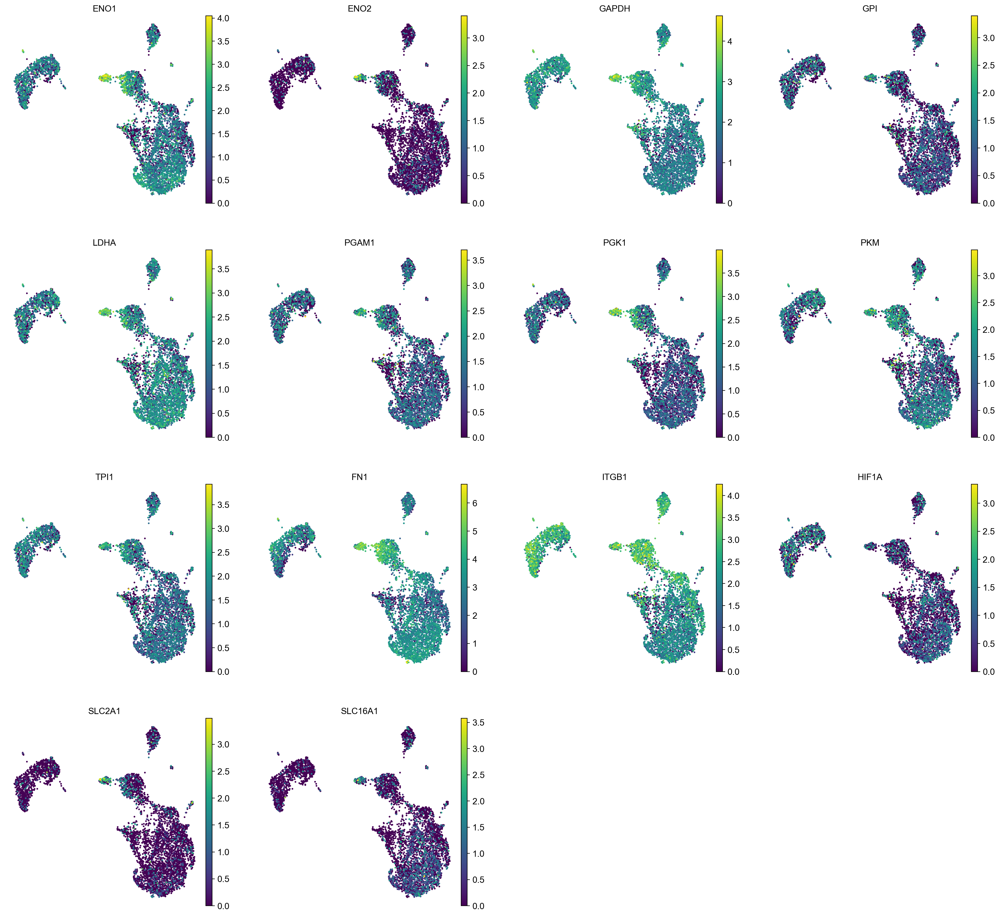

In [6]:
genelist = [
    "ENO1",
    "ENO2",
    "GAPDH",
    "GPI",
    "LDHA",
    "PGAM1",
    "PGK1",
    "PKM",
    "TPI1",
    "FN1",
    "ITGB1",
    "HIF1A",
    "SLC2A1",
    "SLC16A1",
]
sc.pl.umap(adata,color=genelist,save='_CAF_gluco_metab_gene_expr.pdf',ncols=4)
# sc.pl.stacked_violin(adata,genelist,groupby='cellsubtype', cmap='viridis_r',save='_CAF_gluco_metab_gene_expr.pdf')

In [12]:
adata_tumor = sc.read(
    "/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/4.8_sc_celltype_hotspot/Epi/adata_scvi.h5ad"
)

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_tools/scatterplots.py:396: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


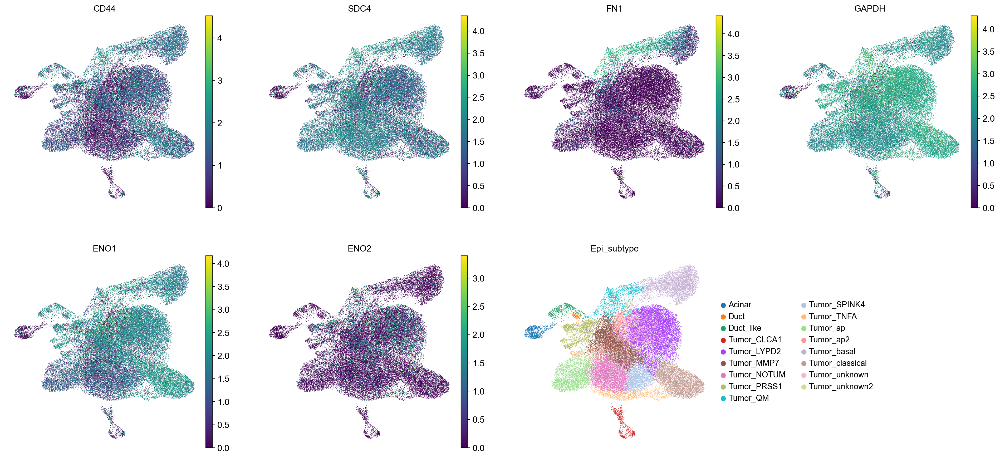

In [16]:
sc.pl.umap(
    adata_tumor,
    color=["CD44", "SDC4", "FN1", "GAPDH", "ENO1", "ENO2", "Epi_subtype"],
    save="_tumor_mme_related_gene_expr.pdf",
    ncols=4,
)